In [1]:
%matplotlib inline

import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import numpy as np

In [2]:
df = pd.read_excel(io='../../DataSets/Product Recommendations/Online Retail.xlsx', sheet_name='Online Retail')

In [3]:
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom


In [4]:
df.shape

(541909, 8)

In [5]:
df.describe()

,Quantity,UnitPrice,CustomerID
count,541909.000000,541909.000000,406829.000000
mean,9.552250,4.611114,15287.690570
std,218.081158,96.759853,1713.600303
min,-80995.000000,-11062.060000,12346.000000
25%,1.000000,1.250000,13953.000000
50%,3.000000,2.080000,15152.000000
75%,10.000000,4.130000,16791.000000
max,80995.000000,38970.000000,18287.000000


In [6]:
df.isnull().sum()

InvoiceNo           0
StockCode           0
Description      1454
Quantity            0
InvoiceDate         0
UnitPrice           0
CustomerID     135080
Country             0
dtype: int64

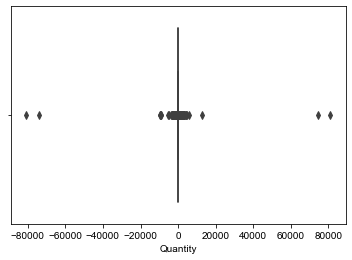

In [7]:
#Quantity has negative values
p = sns.boxplot(x=df['Quantity'])
sns.set_theme(style="whitegrid")
plt.show(p)

In [8]:
#Exclude canceled 
df = df[df['Quantity']>0]

In [9]:
#Monthly Orders
monthly_orders_df = pd.DataFrame(df.set_index('InvoiceDate')['InvoiceNo'].resample('M').nunique())

In [10]:
print(monthly_orders_df)

             InvoiceNo
InvoiceDate           
2010-12-31        1629
2011-01-31        1120
2011-02-28        1126
2011-03-31        1531
2011-04-30        1318
2011-05-31        1731
2011-06-30        1576
2011-07-31        1540
2011-08-31        1409
2011-09-30        1896
2011-10-31        2129
2011-11-30        2884
2011-12-31         839


<AxesSubplot:xlabel='InvoiceDate', ylabel='InvoiceNo'>

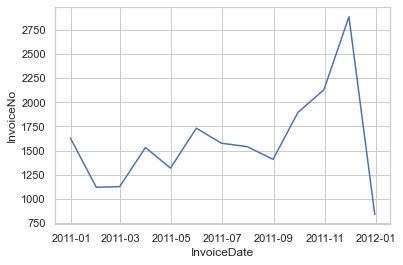

In [11]:
sns.lineplot(x='InvoiceDate',y='InvoiceNo',data=monthly_orders_df)

In [12]:
invoice_dates = df[df['InvoiceDate']>='2011-12-01']['InvoiceDate']

In [13]:
#December orders
print('Min date: %s\nMax date: %s' % (invoice_dates.min(), invoice_dates.max()))

Min date: 2011-12-01 08:33:00
Max date: 2011-12-09 12:50:00


In [14]:
#Removing December because data is incomplete
df = df[df['InvoiceDate']<='2011-12-01']
monthly_orders_df = pd.DataFrame(df.set_index('InvoiceDate')['InvoiceNo'].resample('M').nunique())

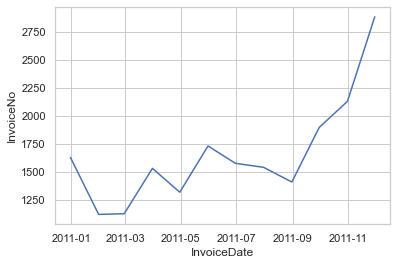

In [15]:
sns.lineplot(x='InvoiceDate',y='InvoiceNo',data=monthly_orders_df)
plt.show()

In [16]:
#Calculating sales
df['Sales']= df['Quantity'] * df['UnitPrice']

#Aggregate by Month
monthly_revenue_df = pd.DataFrame(df.set_index('InvoiceDate')['Sales']).resample('M').sum()

In [17]:
monthly_revenue_df

,Sales
InvoiceDate,
2010-12-31,823746.140
2011-01-31,691364.560
2011-02-28,523631.890
2011-03-31,717639.360
2011-04-30,537808.621
2011-05-31,770536.020
2011-06-30,761739.900
2011-07-31,719221.191
2011-08-31,737014.260


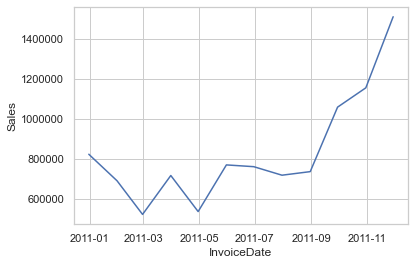

In [18]:
ax = sns.lineplot(x='InvoiceDate',y='Sales',data=monthly_revenue_df)
plt.ticklabel_format(style='plain', axis='y')
plt.show()

In [19]:
#Customer purchases
invoice_customer_df = df.groupby(by=['InvoiceNo','InvoiceDate']).agg(
{'Sales':sum,
 'CustomerID':max,
 'Country':max
}).reset_index()

In [20]:
invoice_customer_df.head()

,InvoiceNo,InvoiceDate,Sales,CustomerID,Country
0,536365,2010-12-01 08:26:00,139.12,17850.0,United Kingdom
1,536366,2010-12-01 08:28:00,22.20,17850.0,United Kingdom
2,536367,2010-12-01 08:34:00,278.73,13047.0,United Kingdom
3,536368,2010-12-01 08:34:00,70.05,13047.0,United Kingdom
4,536369,2010-12-01 08:35:00,17.85,13047.0,United Kingdom


In [21]:
#customer who made more that one purchase per month
monthly_repeat_customer_df = pd.DataFrame(invoice_customer_df.set_index('InvoiceDate').groupby(
[pd.Grouper(freq='M'),'CustomerID']).filter(lambda x: len(x)>1).resample('M').nunique()['CustomerID'])

In [22]:
monthly_repeat_customer_df

,CustomerID
InvoiceDate,
2010-12-31,263
2011-01-31,153
2011-02-28,153
2011-03-31,203
2011-04-30,170
2011-05-31,281
2011-06-30,220
2011-07-31,227
2011-08-31,198


In [23]:
#Total monthly customer
monthly_unique_customers_df = pd.DataFrame(df.set_index('InvoiceDate')['CustomerID'].resample('M').nunique())
monthly_unique_customers_df

,CustomerID
InvoiceDate,
2010-12-31,885
2011-01-31,741
2011-02-28,758
2011-03-31,974
2011-04-30,856
2011-05-31,1056
2011-06-30,991
2011-07-31,949
2011-08-31,935


In [24]:
#Percentage of repeat customers
monthly_repeat_percentage = monthly_repeat_customer_df/monthly_unique_customers_df*100.0

In [25]:
monthly_repeat_percentage

,CustomerID
InvoiceDate,
2010-12-31,29.717514
2011-01-31,20.647773
2011-02-28,20.184697
2011-03-31,20.841889
2011-04-30,19.859813
2011-05-31,26.609848
2011-06-30,22.199798
2011-07-31,23.919916
2011-08-31,21.176471


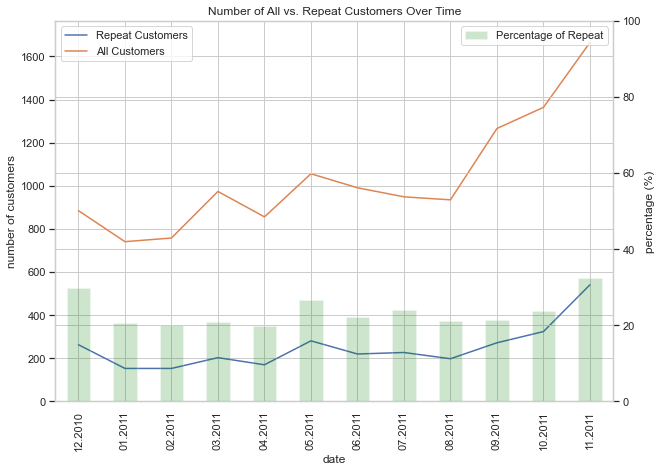

In [26]:
ax= pd.DataFrame(monthly_repeat_customer_df.values).plot(figsize=(10,7))

pd.DataFrame(monthly_unique_customers_df.values).plot(ax=ax,grid=True)

ax2= pd.DataFrame(monthly_repeat_percentage.values).plot.bar(
    ax=ax, grid=True, secondary_y=True, color='green', alpha=0.2
)

ax.set_xlabel('date')
ax.set_ylabel('number of customers')
ax.set_title('Number of All vs. Repeat Customers Over Time')
ax2.set_ylabel('percentage (%)')
ax.legend(['Repeat Customers', 'All Customers'])
ax2.legend(['Percentage of Repeat'], loc='upper right')
ax.set_ylim([0, monthly_unique_customers_df.values.max()+100])
ax2.set_ylim([0, 100])

plt.xticks(
    range(len(monthly_repeat_customer_df.index)), 
    [x.strftime('%m.%Y') for x in monthly_repeat_customer_df.index], 
    rotation=45
)
plt.show()


In [27]:
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Sales
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom,22.00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom,20.34


In [28]:
%config Completer.use_jedi = False

In [29]:
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode,iplot,plot
from plotly import tools
init_notebook_mode(connected=True)

In [30]:
trace1 = go.Scatter(
    x= df.InvoiceDate,
    y= df.Sales,
    mode = 'lines'
)
data = trace1
layout = dict(
    title = 'sales over time',
    xaxis= dict(title='time'),
    yaxis= dict(title='Sales')
)

fig = dict(data=data, layout=layout)
iplot(fig)

In [31]:
top_products_df = pd.DataFrame(df.groupby('Description')[['Sales','Quantity']].sum()).sort_values(by='Sales',ascending=False).head(10).reset_index()
top_products_df

,Description,Sales,Quantity
0,DOTCOM POSTAGE,186376.08,691
1,REGENCY CAKESTAND 3 TIER,168477.87,13440
2,WHITE HANGING HEART T-LIGHT HOLDER,104085.75,37117
3,PARTY BUNTING,98585.85,18163
4,JUMBO BAG RED RETROSPOT,92113.15,47373
5,MEDIUM CERAMIC TOP STORAGE JAR,81448.21,77826
6,Manual,77674.72,6412
7,POSTAGE,75336.59,3026
8,PAPER CHAIN KIT 50'S CHRISTMAS,58081.58,17266
9,RABBIT NIGHT LIGHT,57321.97,26477


In [32]:
trace1 = go.Bar(
    x=top_products_df.Description,
    y=top_products_df.Sales
)
data= trace1
layout = go.Layout(barmode='group')
fig = go.Figure(data=data, layout=layout)
iplot(fig)


In [33]:
y_sales = [each for each in top_products_df.Sales]
y_quantity = [each for each in top_products_df.Quantity]
x_sales = [each for each in top_products_df.Description]
x_quantity = [each for each in top_products_df.Description]

trace0 = go.Bar(
    x=y_sales,
    y=x_sales,
    marker=dict(color='rgba(171, 50, 96, 0.6)',line=dict(color='rgba(171, 50, 96, 1.0)',width=1)),
    name='Sales',
    orientation='h'
)
trace1 = go.Scatter(
    x=y_quantity,
    y=x_quantity,
    mode='lines+markers',
    line=dict(color='blue'),
    name='Quantity'
)

layout=dict(
    title=('Top 10 products Sales and Quantity'),
    yaxis=dict(showticklabels=True,domain=[0,0.85] ),
    yaxis2=dict(showline=True,showticklabels=False,linecolor='rgba(102, 102, 102, 0.8)', domain=[0,0.85]),
    xaxis=dict(zeroline=False,showline=False,showticklabels=True,showgrid=True,domain=[0, 0.42]),
    xaxis2=dict(zeroline=False,showline=False,showticklabels=True,showgrid=True,domain=[0.47, 1],side='top'),
    legend=dict(x=0.029,y=1.038,font=(dict(size=10))),
    margin=dict(l=200, r=20,t=70,b=70),
    paper_bgcolor='rgb(248, 248, 255)',
    plot_bgcolor='rgb(248, 248, 255)',
)



annotations = []
y_s = np.round(y_sales, decimals=2)
y_q = np.rint(y_quantity)

for ydn, yd, xd in zip(y_q,y_s,x_sales):
    annotations.append(dict(xref='x2', yref='y2', y=xd, x=ydn -4, text='{:,}'.format(ydn),font=dict(family='Arial', size=12,color='rgb(63, 72, 204)'),showarrow=True))
    annotations.append(dict(xref='x1', yref='y1', y=xd, x=yd+3, text=str(yd),font=dict(family='Arial', size=12,color='rgb(171, 50, 96)'),showarrow=False))
    
layout['annotations'] = annotations

fig = tools.make_subplots(rows=1,cols=2,specs=[[{},{}]],shared_xaxes=True,shared_yaxes=False,vertical_spacing=0.001)

fig.append_trace(trace0,1,1)
fig.append_trace(trace1,1,2)
fig['layout'].update(layout)
iplot(fig)
    

C:\Users\hbkmi\Anaconda3\lib\site-packages\plotly\tools.py:465: DeprecationWarning:

plotly.tools.make_subplots is deprecated, please use plotly.subplots.make_subplots instead



In [34]:
country_customer_df = df.groupby('Country').agg({"Sales": np.sum, "CustomerID": pd.Series.nunique}).reset_index()
country_customer_df

,Country,Sales,CustomerID
0,Australia,1.385213e+05,9.0
1,Austria,9.515480e+03,11.0
2,Bahrain,7.541400e+02,2.0
3,Belgium,3.977861e+04,25.0
4,Brazil,1.143600e+03,1.0
5,Canada,3.666380e+03,4.0
6,Channel Islands,2.025204e+04,9.0
7,Cyprus,1.359038e+04,8.0
8,Czech Republic,8.267400e+02,1.0
9,Denmark,1.878644e+04,8.0


In [35]:
traces = []
for c, tmp in country_customer_df.groupby('Country'):
    traces.append(go.Scatter(x=tmp.Sales,y=tmp.CustomerID, name=c, mode='markers'))
fig = go.Figure(data=traces)
iplot(fig)

In [46]:
import dash
from jupyter_dash import JupyterDash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input,Output,State
import plotly.express as px

In [47]:
country_month_df = pd.DataFrame()
for country in df.Country.unique():
    country_customer_df= df[df.Country == country].set_index(['InvoiceDate'])[['Sales','CustomerID','InvoiceNo']].resample('M').agg({"Sales": np.sum, "CustomerID": pd.Series.nunique,"InvoiceNo":pd.Series.nunique}).reset_index()
    country_customer_df = country_customer_df[country_customer_df.InvoiceDate>'2010-12-31']
    country_customer_df.InvoiceDate = country_customer_df.InvoiceDate.astype(str)
    country_customer_df['Country'] = country
    country_month_df = country_month_df.append(country_customer_df,ignore_index=True)
    
country_month_df 

,InvoiceDate,Sales,CustomerID,InvoiceNo,Country
0,2011-01-31,561289.980,647.0,1005,United Kingdom
1,2011-02-28,430027.950,679.0,1021,United Kingdom
2,2011-03-31,586230.280,880.0,1385,United Kingdom
3,2011-04-30,476517.761,784.0,1225,United Kingdom
4,2011-05-31,639314.360,962.0,1573,United Kingdom
...,...,...,...,...,...
320,2011-08-31,1119.000,2.0,2,Malta
321,2011-09-30,0.000,0.0,0,Malta
322,2011-10-31,0.000,0.0,0,Malta
323,2011-11-30,743.430,1.0,1,Malta


In [53]:


app = JupyterDash(__name__)

app.layout = html.Div([
    dcc.Graph(id='graph-with-slider'),
    dcc.Slider(
        id='month-slider',
        min=0,
        max=len(country_month_df.InvoiceDate.unique()),
        value=0,
        marks={i:str(date) for i, date in enumerate(country_month_df.InvoiceDate.unique())},
        step=None
    )
])

@app.callback(
    Output('graph-with-slider','figure'),
    Input('month-slider','value'),
    State('month-slider','marks')
)

def update_figure(selected_date,marks):
    selected = marks[str(selected_date)]
    filtered_df = country_month_df[country_month_df.InvoiceDate == selected]
    
    fig = px.scatter(filtered_df, x='CustomerID',y='InvoiceNo',size='Sales', color='Country'
                    ,hover_name='Country',size_max=60)
    fig.update_layout(transition_duration=400)
    
    return fig


app.run_server(mode='jupyterlab',debug=False)

OSError: Address 'http://127.0.0.1:8050' already in use.
    Try passing a different port to run_server.

# Recomending Products

# User Based

In [39]:
#drop missing values in customerID
df = df.dropna(subset=['CustomerID'])

In [40]:
df.isnull().sum()

InvoiceNo      0
StockCode      0
Description    0
Quantity       0
InvoiceDate    0
UnitPrice      0
CustomerID     0
Country        0
Sales          0
dtype: int64

In [42]:
df.shape

(380620, 9)

In [44]:
#Buid customer - item matrix
customer_item_matrix = df.pivot_table(
    index='CustomerID',
    columns='StockCode',
    values='Quantity',
    aggfunc='sum'
)
customer_item_matrix.head()

StockCode,10002,10080,10120,10125,10133,10135,11001,15030,15034,15036,...,90214R,90214S,90214V,90214Y,BANK CHARGES,C2,DOT,M,PADS,POST
CustomerID,,,,,,,,,,,,,,,,,,,,,
12346.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12347.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12348.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.0
12349.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
12350.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0


In [45]:
#encode data
customer_item_matrix = customer_item_matrix.applymap(lambda x: 1 if x>0 else 0)
customer_item_matrix.head()

StockCode,10002,10080,10120,10125,10133,10135,11001,15030,15034,15036,...,90214R,90214S,90214V,90214Y,BANK CHARGES,C2,DOT,M,PADS,POST
CustomerID,,,,,,,,,,,,,,,,,,,,,
12346.0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
12347.0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
12348.0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
12349.0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
12350.0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [46]:
from sklearn.metrics.pairwise import cosine_similarity


In [50]:
#Calculate Cosine Similarity
user_user_sim_matrix= pd.DataFrame(
    cosine_similarity(customer_item_matrix)
)
user_user_sim_matrix.head()

,0,1,2,3,4,5,6,7,8,9,...,4288,4289,4290,4291,4292,4293,4294,4295,4296,4297
0,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,...,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
1,0.0,1.000000,0.063960,0.035112,0.048507,0.039057,0.0,0.026261,0.138675,0.096152,...,0.0,0.030151,0.053452,0.0,0.033333,0.063246,0.0,0.000000,0.111847,0.013019
2,0.0,0.063960,1.000000,0.024953,0.051709,0.027756,0.0,0.027995,0.118262,0.146427,...,0.0,0.064282,0.113961,0.0,0.000000,0.000000,0.0,0.000000,0.158972,0.083269
3,0.0,0.035112,0.024953,1.000000,0.056773,0.137137,0.0,0.030737,0.032461,0.144692,...,0.0,0.105868,0.000000,0.0,0.039014,0.000000,0.0,0.044237,0.138179,0.030475
4,0.0,0.048507,0.051709,0.056773,1.000000,0.031575,0.0,0.000000,0.000000,0.033315,...,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.045211,0.000000


In [51]:
#Renaming colimns and inedex
user_user_sim_matrix.columns = customer_item_matrix.index
user_user_sim_matrix['CustomerID'] = customer_item_matrix.index
user_user_sim_matrix = user_user_sim_matrix.set_index('CustomerID')
user_user_sim_matrix

CustomerID,12346.0,12347.0,12348.0,12349.0,12350.0,12352.0,12353.0,12354.0,12355.0,12356.0,...,18273.0,18274.0,18276.0,18277.0,18278.0,18280.0,18281.0,18282.0,18283.0,18287.0
CustomerID,,,,,,,,,,,,,,,,,,,,,
12346.0,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
12347.0,0.0,1.000000,0.063960,0.035112,0.048507,0.039057,0.0,0.026261,0.138675,0.096152,...,0.0,0.030151,0.053452,0.000000,0.033333,0.063246,0.000000,0.000000,0.111847,0.013019
12348.0,0.0,0.063960,1.000000,0.024953,0.051709,0.027756,0.0,0.027995,0.118262,0.146427,...,0.0,0.064282,0.113961,0.000000,0.000000,0.000000,0.000000,0.000000,0.158972,0.083269
12349.0,0.0,0.035112,0.024953,1.000000,0.056773,0.137137,0.0,0.030737,0.032461,0.144692,...,0.0,0.105868,0.000000,0.000000,0.039014,0.000000,0.000000,0.044237,0.138179,0.030475
12350.0,0.0,0.048507,0.051709,0.056773,1.000000,0.031575,0.0,0.000000,0.000000,0.033315,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.045211,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18280.0,0.0,0.063246,0.000000,0.000000,0.000000,0.000000,0.0,0.041523,0.000000,0.000000,...,0.0,0.000000,0.000000,0.000000,0.105409,1.000000,0.119523,0.000000,0.000000,0.000000
18281.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.049629,0.000000,0.000000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.119523,1.000000,0.000000,0.046971,0.000000
18282.0,0.0,0.000000,0.000000,0.044237,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,...,0.0,0.113961,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.023486,0.000000


In [52]:
#similar users to user 12350.0
user_user_sim_matrix.loc[12350.0].sort_values(ascending=False)

CustomerID
12350.0    1.000000
17935.0    0.183340
12414.0    0.181902
12652.0    0.175035
16754.0    0.171499
             ...   
14882.0    0.000000
14883.0    0.000000
14885.0    0.000000
14886.0    0.000000
18287.0    0.000000
Name: 12350.0, Length: 4298, dtype: float64

In [57]:
#Items bought by 12350.0 user
items_bought_by_A = set(customer_item_matrix.loc[12350.0].iloc[
    customer_item_matrix.loc[12350.0].to_numpy().nonzero()
].index)
items_bought_by_A

{20615,
 20652,
 21171,
 21832,
 21864,
 21866,
 21908,
 21915,
 22348,
 22412,
 22551,
 22557,
 22620,
 '79066K',
 '79191C',
 '84086C',
 'POST'}

In [58]:
#items bought by the most similar user 17935
items_bought_by_B = set(customer_item_matrix.loc[17935.0].iloc[
    customer_item_matrix.loc[17935].to_numpy().nonzero()
].index)
items_bought_by_B

{20657,
 20659,
 20828,
 20856,
 21051,
 21866,
 21867,
 22208,
 22209,
 22210,
 22211,
 22449,
 22450,
 22551,
 22553,
 22557,
 22640,
 22659,
 22749,
 22752,
 22753,
 22754,
 22755,
 23290,
 23292,
 23309,
 '85099B',
 'POST'}

In [60]:
#Items to recommend
items_to_recommend_to_B = items_bought_by_A - items_bought_by_B

In [61]:
df.loc[
    df['StockCode'].isin(items_to_recommend_to_B), 
    ['StockCode', 'Description']
].drop_duplicates().set_index('StockCode')

,Description
StockCode,
21832,CHOCOLATE CALCULATOR
21915,RED HARMONICA IN BOX
22620,4 TRADITIONAL SPINNING TOPS
79066K,RETRO MOD TRAY
21864,UNION JACK FLAG PASSPORT COVER
79191C,RETRO PLASTIC ELEPHANT TRAY
21908,CHOCOLATE THIS WAY METAL SIGN
20615,BLUE POLKADOT PASSPORT COVER
20652,BLUE POLKADOT LUGGAGE TAG


# Item Based

In [62]:
customer_item_matrix.T

CustomerID,12346.0,12347.0,12348.0,12349.0,12350.0,12352.0,12353.0,12354.0,12355.0,12356.0,...,18273.0,18274.0,18276.0,18277.0,18278.0,18280.0,18281.0,18282.0,18283.0,18287.0
StockCode,,,,,,,,,,,,,,,,,,,,,
10002,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
10080,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
10120,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
10125,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
10133,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
C2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
DOT,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
M,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0


In [63]:
item_item_sim_matrix = pd.DataFrame(
    cosine_similarity(customer_item_matrix.T)
)
item_item_sim_matrix

,0,1,2,3,4,5,6,7,8,9,...,3647,3648,3649,3650,3651,3652,3653,3654,3655,3656
0,1.000000,0.000000,0.094868,0.091287,0.062932,0.099449,0.097590,0.050000,0.075593,0.091050,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.029361,0.0,0.067250,0.000000,0.070382
1,0.000000,1.000000,0.000000,0.033113,0.045655,0.048099,0.000000,0.000000,0.082261,0.049541,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.016263,0.000000,0.000000
2,0.094868,0.000000,1.000000,0.057735,0.059702,0.041931,0.061721,0.063246,0.095618,0.028793,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.070888,0.000000,0.011128
3,0.091287,0.033113,0.057735,1.000000,0.043086,0.045392,0.044544,0.000000,0.051755,0.031169,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.071623,0.000000,0.064249
4,0.062932,0.045655,0.059702,0.043086,1.000000,0.271201,0.046061,0.062932,0.071358,0.057299,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.036955,0.0,0.070536,0.049752,0.022146
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3652,0.029361,0.000000,0.000000,0.000000,0.036955,0.019466,0.057307,0.000000,0.000000,0.040100,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.0,0.026327,0.000000,0.020665
3653,0.000000,0.000000,0.000000,0.000000,0.000000,0.104828,0.154303,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,0.000000,0.000000
3654,0.067250,0.016263,0.070888,0.071623,0.070536,0.066880,0.098444,0.067250,0.059309,0.086745,...,0.070888,0.050125,0.070888,0.070888,0.094517,0.026327,0.0,1.000000,0.000000,0.078886
3655,0.000000,0.000000,0.000000,0.000000,0.049752,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,1.000000,0.000000


In [64]:
item_item_sim_matrix.columns = customer_item_matrix.T.index

item_item_sim_matrix['StockCode'] = customer_item_matrix.T.index
item_item_sim_matrix = item_item_sim_matrix.set_index('StockCode')
item_item_sim_matrix

StockCode,10002,10080,10120,10125,10133,10135,11001,15030,15034,15036,...,90214R,90214S,90214V,90214Y,BANK CHARGES,C2,DOT,M,PADS,POST
StockCode,,,,,,,,,,,,,,,,,,,,,
10002,1.000000,0.000000,0.094868,0.091287,0.062932,0.099449,0.097590,0.050000,0.075593,0.091050,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.029361,0.0,0.067250,0.000000,0.070382
10080,0.000000,1.000000,0.000000,0.033113,0.045655,0.048099,0.000000,0.000000,0.082261,0.049541,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.016263,0.000000,0.000000
10120,0.094868,0.000000,1.000000,0.057735,0.059702,0.041931,0.061721,0.063246,0.095618,0.028793,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.070888,0.000000,0.011128
10125,0.091287,0.033113,0.057735,1.000000,0.043086,0.045392,0.044544,0.000000,0.051755,0.031169,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.071623,0.000000,0.064249
10133,0.062932,0.045655,0.059702,0.043086,1.000000,0.271201,0.046061,0.062932,0.071358,0.057299,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.036955,0.0,0.070536,0.049752,0.022146
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
C2,0.029361,0.000000,0.000000,0.000000,0.036955,0.019466,0.057307,0.000000,0.000000,0.040100,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.0,0.026327,0.000000,0.020665
DOT,0.000000,0.000000,0.000000,0.000000,0.000000,0.104828,0.154303,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,0.000000,0.000000
M,0.067250,0.016263,0.070888,0.071623,0.070536,0.066880,0.098444,0.067250,0.059309,0.086745,...,0.070888,0.050125,0.070888,0.070888,0.094517,0.026327,0.0,1.000000,0.000000,0.078886


In [68]:
def recommnder(item):
    top_10_similar_items = list(
        item_item_sim_matrix.loc[item].sort_values(ascending=False).iloc[:10].index
    )
    products = df.loc[
        df['StockCode'].isin(top_10_similar_items),['StockCode','Description']
    ].drop_duplicates().set_index('StockCode').loc[top_10_similar_items]
    
    return products

In [70]:
print(df[df.StockCode==23166]['Description'].drop_duplicates())
recommnder(23166)

61619    MEDIUM CERAMIC TOP STORAGE JAR
Name: Description, dtype: object


,Description
StockCode,
23166,MEDIUM CERAMIC TOP STORAGE JAR
23165,LARGE CERAMIC TOP STORAGE JAR
23167,SMALL CERAMIC TOP STORAGE JAR
22993,SET OF 4 PANTRY JELLY MOULDS
23307,SET OF 60 PANTRY DESIGN CAKE CASES
22722,SET OF 6 SPICE TINS PANTRY DESIGN
22720,SET OF 3 CAKE TINS PANTRY DESIGN
23243,SET OF TEA COFFEE SUGAR TINS PANTRY
22961,JAM MAKING SET PRINTED


In [72]:
print(df[df.StockCode==22726]['Description'].drop_duplicates())
recommnder(22726)

28    ALARM CLOCK BAKELIKE GREEN
Name: Description, dtype: object


,Description
StockCode,
22726,ALARM CLOCK BAKELIKE GREEN
22727,ALARM CLOCK BAKELIKE RED
22728,ALARM CLOCK BAKELIKE PINK
22730,ALARM CLOCK BAKELIKE IVORY
22729,ALARM CLOCK BAKELIKE ORANGE
22725,ALARM CLOCK BAKELIKE CHOCOLATE
22192,BLUE DINER WALL CLOCK
22193,RED DINER WALL CLOCK
22191,IVORY DINER WALL CLOCK


In [73]:

print(df[df.StockCode=='85049G']['Description'].drop_duplicates())
recommnder('85049G')

399    CHOCOLATE BOX RIBBONS 
Name: Description, dtype: object


,Description
StockCode,
85049G,CHOCOLATE BOX RIBBONS
85049C,ROMANTIC PINKS RIBBONS
85049D,BRIGHT BLUES RIBBONS
85049F,BABY BOOM RIBBONS
85049E,SCANDINAVIAN REDS RIBBONS
85049H,URBAN BLACK RIBBONS
22077,6 RIBBONS RUSTIC CHARM
85049A,TRADITIONAL CHRISTMAS RIBBONS
22075,6 RIBBONS ELEGANT CHRISTMAS
